In [2]:
#question 1:
import pandas as pd
url='http://web.mta.info/developers/data/nyct/turnstile/turnstile_{}.txt'
li=[]
def read_in_files(filelist):
    for file in filelist:
        df=pd.read_csv(url.format(file))
        li.append(df)
        frame=pd.concat(li,axis=0,ignore_index=True)
    return frame
frame=read_in_files(['200627','200620','200613'])
frame.rename(columns={frame.columns[-1]:'EXITS'},inplace=True)
frame.columns=[column.strip() for column in frame.columns]
frame.head(10)




,C/A,UNIT,SCP,STATION,LINENAME,DIVISION,DATE,TIME,DESC,ENTRIES,EXITS
0,A002,R051,02-00-00,59 ST,NQR456W,BMT,06/20/2020,00:00:00,REGULAR,7424218,2522558
1,A002,R051,02-00-00,59 ST,NQR456W,BMT,06/20/2020,04:00:00,REGULAR,7424220,2522559
2,A002,R051,02-00-00,59 ST,NQR456W,BMT,06/20/2020,08:00:00,REGULAR,7424231,2522572
3,A002,R051,02-00-00,59 ST,NQR456W,BMT,06/20/2020,12:00:00,REGULAR,7424265,2522590
4,A002,R051,02-00-00,59 ST,NQR456W,BMT,06/20/2020,16:00:00,REGULAR,7424340,2522604
5,A002,R051,02-00-00,59 ST,NQR456W,BMT,06/20/2020,20:00:00,REGULAR,7424415,2522612
6,A002,R051,02-00-00,59 ST,NQR456W,BMT,06/21/2020,00:00:00,REGULAR,7424441,2522622
7,A002,R051,02-00-00,59 ST,NQR456W,BMT,06/21/2020,04:00:00,REGULAR,7424443,2522623
8,A002,R051,02-00-00,59 ST,NQR456W,BMT,06/21/2020,08:00:00,REGULAR,7424457,2522628
9,A002,R051,02-00-00,59 ST,NQR456W,BMT,06/21/2020,12:00:00,REGULAR,7424471,2522645


In [11]:

from collections import defaultdict
dict_train={}
key=()
value=[]
dict_train=defaultdict(list)
for row in frame.itertuples():
    key=row[1:5]
    value=[row[5:]]
    dict_train[key].append(value)
    
#d = defaultdict(list)
#for row in df.head(1000).itertuples():
#    d[(row[1:5])].append([row[5:]])
#d

dict_train

defaultdict(list,
            {('A002',
              'R051',
              '02-00-00',
              '59 ST'): [[('NQR456W',
                'BMT',
                '06/20/2020',
                '00:00:00',
                'REGULAR',
                7424218,
                2522558,
                Timestamp('2020-06-20 00:00:00'))], [('NQR456W',
                'BMT',
                '06/20/2020',
                '04:00:00',
                'REGULAR',
                7424220,
                2522559,
                Timestamp('2020-06-20 04:00:00'))], [('NQR456W',
                'BMT',
                '06/20/2020',
                '08:00:00',
                'REGULAR',
                7424231,
                2522572,
                Timestamp('2020-06-20 08:00:00'))], [('NQR456W',
                'BMT',
                '06/20/2020',
                '12:00:00',
                'REGULAR',
                7424265,
                2522590,
                Timestamp('2020-06-20 12:00:00'

In [3]:
#question 2:
frame['datetime']=pd.to_datetime(frame['DATE']+" "+frame['TIME'])

In [14]:
#Takes a long time to run - may not work
dict_train2={}
key=()
value=[]
prev_key=()
prev_entries=0
import dateutil.parser
frame=frame.sort_values(by=['C/A', 'UNIT','SCP','STATION','DATE','TIME'], ascending=True)

for index, row in frame.iterrows():
    key=(row['C/A'],row['UNIT'],row['SCP'],row['STATION'])
    #give NaN to the first entry, and give the difference of entries to others.
    if key==prev_key:
        row['no_entry']=float(row['ENTRIES'])-float(prev_entries)
    else:
        row['no_entry']=float("NaN")
    prev_key=key
    prev_entries=row['ENTRIES']
    #convert datetime
    row['datetime2']=dateutil.parser.parse(row['DATE']+" "+row['TIME'])
    
    value=[row['datetime2'],row['no_entry']]
    if key in dict_train2:
        dict_train2[key].append(value)
    else:
        dict_train2[key]=[value]

dict_train2

KeyboardInterrupt: 

In [50]:
#My code -DO NOT USE
frame=frame.sort_values(by=['C/A','UNIT','SCP','STATION','DATE','TIME'], ascending=True)
frame['ENTRIES2'] = pd.to_numeric(frame['ENTRIES'], downcast='float')
frame['key']=frame['C/A']+frame['UNIT']+frame['SCP']+frame['STATION']
frame2=frame.groupby(['C/A','UNIT','SCP','STATION','key','DATE'])[['ENTRIES2']].agg(['min']).reset_index()#.set_index('key')
frame2['Number of Entries'] = frame2['ENTRIES2'].shift(-1)-frame2['ENTRIES2']


    
#frame2=frame2.drop(frame2.columns[6], axis=1)
frame2.columns = frame2.columns.droplevel(-1)
last_key=''
for index,row in frame2[::-1].iterrows():
    if row['key']!=last_key:
        frame2.set_value(index,'Number of Entries',float("NaN"))
        #print(frame2.loc[index,'Number of Entries'])
    else:
        continue
    last_key=row['key']
del frame2['key']
#for index,row in frame2.iterrows():
#    print(frame)
frame2.head(100)


/Users/dengcg1992/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: FutureWarning: set_value is deprecated and will be removed in a future release. Please use .at[] or .iat[] accessors instead
  from ipykernel import kernelapp as app


,C/A,UNIT,SCP,STATION,DATE,ENTRIES2,Number of Entries
0,A002,R051,02-00-00,59 ST,04/04/2020,7413507.0,77.0
1,A002,R051,02-00-00,59 ST,04/05/2020,7413584.0,51.0
2,A002,R051,02-00-00,59 ST,04/06/2020,7413635.0,102.0
3,A002,R051,02-00-00,59 ST,04/07/2020,7413737.0,105.0
4,A002,R051,02-00-00,59 ST,04/08/2020,7413842.0,94.0
5,A002,R051,02-00-00,59 ST,04/09/2020,7413936.0,90.0
6,A002,R051,02-00-00,59 ST,04/10/2020,7414026.0,71.0
7,A002,R051,02-00-00,59 ST,04/11/2020,7414097.0,72.0
8,A002,R051,02-00-00,59 ST,04/12/2020,7414169.0,50.0
9,A002,R051,02-00-00,59 ST,04/13/2020,7414219.0,89.0


In [4]:
#question 3:
pd.set_option('display.max_rows', 1000)
frame.sort_values(['C/A','UNIT','SCP','STATION','DATE','TIME'],inplace=True)
frame2=frame.groupby(['C/A','UNIT','SCP','STATION','DATE']).ENTRIES.first().reset_index()
frame2[['later_date','later_entries']]=(frame2.groupby(["C/A","UNIT","SCP","STATION"])["DATE","ENTRIES"].apply(lambda x:x.shift(-1)))
frame2.dropna(subset=['later_date'], axis=0,inplace=True)

def get_daily_counts(row, max_counter):
    counter = row["later_entries"] - row["ENTRIES"]
    if counter < 0:
        counter = -counter
    if counter > max_counter:
        counter = min(row["ENTRIES"], row["later_entries"])
    if counter > max_counter:
        return 0
    return counter

frame2["Daily_Entries"] = frame2.apply(get_daily_counts, axis=1, max_counter=1000000)
frame2.drop(['ENTRIES', 'later_date','later_entries'], axis=1,inplace=True)

frame2.head(100)

,C/A,UNIT,SCP,STATION,DATE,Daily_Entries
0,A002,R051,02-00-00,59 ST,06/06/2020,105.0
1,A002,R051,02-00-00,59 ST,06/07/2020,123.0
2,A002,R051,02-00-00,59 ST,06/08/2020,241.0
3,A002,R051,02-00-00,59 ST,06/09/2020,250.0
4,A002,R051,02-00-00,59 ST,06/10/2020,250.0
5,A002,R051,02-00-00,59 ST,06/11/2020,235.0
6,A002,R051,02-00-00,59 ST,06/12/2020,258.0
7,A002,R051,02-00-00,59 ST,06/13/2020,189.0
8,A002,R051,02-00-00,59 ST,06/14/2020,144.0
9,A002,R051,02-00-00,59 ST,06/15/2020,289.0


([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19],
 <a list of 20 Text xticklabel objects>)

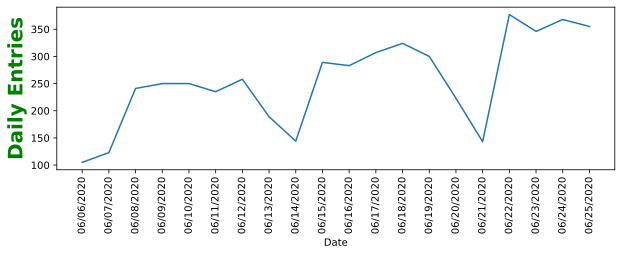

In [5]:
#question 4:
%matplotlib inline
import matplotlib.pyplot as plt
%config InlineBackend.figure_format = 'svg'
plt.figure(figsize=(10,3))
frame3=frame2[(frame2['C/A']=="A002")&(frame2['UNIT']=="R051")&(frame2['SCP']=="02-00-00")&(frame2['STATION']=="59 ST")]
plt.plot(frame3['DATE'],frame3['Daily_Entries'])
plt.xlabel('Date')
plt.ylabel('Daily Entries',fontsize = 20, weight = 'bold',color='green')
plt.xticks(rotation=90)

In [6]:
#question 5:
frame4=frame2.groupby(['C/A','UNIT','STATION','DATE']).Daily_Entries.sum().reset_index()
frame4.head(100)

,C/A,UNIT,STATION,DATE,Daily_Entries
0,A002,R051,59 ST,06/06/2020,949.0
1,A002,R051,59 ST,06/07/2020,824.0
2,A002,R051,59 ST,06/08/2020,1871.0
3,A002,R051,59 ST,06/09/2020,1946.0
4,A002,R051,59 ST,06/10/2020,1978.0
5,A002,R051,59 ST,06/11/2020,1913.0
6,A002,R051,59 ST,06/12/2020,1954.0
7,A002,R051,59 ST,06/13/2020,1234.0
8,A002,R051,59 ST,06/14/2020,943.0
9,A002,R051,59 ST,06/15/2020,2129.0


In [27]:
#question 6:
frame5=frame2.groupby(['STATION','DATE'])[['Daily_Entries']].sum().reset_index().set_index('STATION')
dictionary_entries = {}
for index,row in frame5.iterrows():
        value=(row.DATE,row['Daily_Entries'])
        #dictionary_entries[index].append(value)
        if index in dictionary_entries:
            dictionary_entries[index].append(value)
        else:
            dictionary_entries[index]=[value]
dictionary_entries


{'1 AV': [('06/06/2020', 1650.0),
  ('06/07/2020', 1290.0),
  ('06/08/2020', 2635.0),
  ('06/09/2020', 2843.0),
  ('06/10/2020', 2948.0),
  ('06/11/2020', 2788.0),
  ('06/12/2020', 3081.0),
  ('06/13/2020', 1928.0),
  ('06/14/2020', 1512.0),
  ('06/15/2020', 2986.0),
  ('06/16/2020', 3197.0),
  ('06/17/2020', 3331.0),
  ('06/18/2020', 3232.0),
  ('06/19/2020', 3369.0),
  ('06/20/2020', 2093.0),
  ('06/21/2020', 1696.0),
  ('06/22/2020', 3519.0),
  ('06/23/2020', 3737.0),
  ('06/24/2020', 3787.0),
  ('06/25/2020', 3869.0)],
 '103 ST': [('06/06/2020', 3327.0),
  ('06/07/2020', 2818.0),
  ('06/08/2020', 5233.0),
  ('06/09/2020', 5502.0),
  ('06/10/2020', 5604.0),
  ('06/11/2020', 5261.0),
  ('06/12/2020', 6004.0),
  ('06/13/2020', 3837.0),
  ('06/14/2020', 3002.0),
  ('06/15/2020', 5693.0),
  ('06/16/2020', 5915.0),
  ('06/17/2020', 5930.0),
  ('06/18/2020', 5960.0),
  ('06/19/2020', 6256.0),
  ('06/20/2020', 3828.0),
  ('06/21/2020', 3066.0),
  ('06/22/2020', 6228.0),
  ('06/23/2020', 65

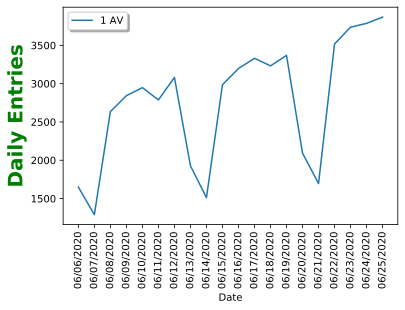

In [8]:
#question 7:
One_Station = dictionary_entries['1 AV']
plt.plot(*zip(*One_Station))
plt.xlabel('Date')
plt.ylabel('Daily Entries',fontsize = 20, weight = 'bold',color='green')
plt.xticks(rotation=90)
plt.legend(['1 AV'],shadow = True, loc = 0);


In [58]:
#question 8:
from dateutil import parser
frame6=frame5.loc[frame5.index=='1 AV']
frame6['day']=frame6.DATE.apply(lambda x:parser.parse(x).strftime("%A"))

frame6_first=frame6[:7]
frame6_second=frame6[7:14]
frame6_third=frame6[14:]




/Users/dengcg1992/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.


In [70]:
#question 9:
frame7=frame5.reset_index()
frame7=frame7.groupby(['STATION'])['Daily_Entries'].sum().reset_index().sort_values(['Daily_Entries'],ascending=False)
#highest traffic station is 116 ST

,STATION,Daily_Entries
6,116 ST,1534146.0
135,B'WAY-LAFAYETTE,1211188.0
255,JEFFERSON ST,596876.0
192,CORTLANDT ST,586546.0
233,GRD CNTRL-42 ST,579990.0
294,NEVINS ST,549447.0
243,HOWARD BCH JFK,524177.0
182,CHRISTOPHER ST,476752.0
270,LEXINGTON AV/53,372713.0
103,79 ST,364288.0


(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.,
        1000000., 1200000., 1400000., 1600000., 1800000.]),
 <a list of 11 Text xticklabel objects>)

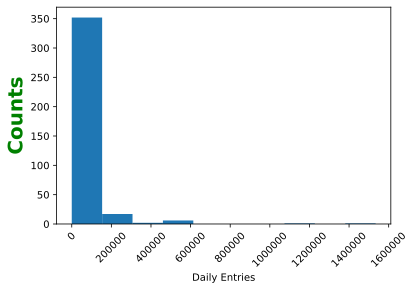

In [78]:
#question 10:
list_station=[]
for row in frame7.itertuples():
        list_station.append(row[2])
plt.hist(list_station)
plt.xlabel('Daily Entries')
plt.ylabel('Counts',fontsize = 20, weight = 'bold',color='green')
plt.xticks(rotation=45)
#plt.legend(['1 AV'],shadow = True, loc = 0);